In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML # Para mostrar la animación en el notebook

# Configuración para las gráficas
plt.style.use('seaborn-v0_8-whitegrid')

In [2]:
class Perceptron:
    def __init__(self, learning_rate=0.01, n_iters=1000):
        self.lr = learning_rate
        self.n_iters = n_iters
        self.activation_func = self._step_function
        self.weights = None
        self.bias = None
        # Historial para animación
        self.weights_history = []
        self.bias_history = []

    def _step_function(self, x):
        # Función escalón de Heaviside
        return np.where(x >= 0, 1, 0)

    def fit(self, X, y):
        n_samples, n_features = X.shape

        # Inicialización de pesos y sesgo
        # self.weights = np.zeros(n_features) # Empezar con ceros
        # Usaremos inicialización aleatoria pequeña para mejor visualización a veces
        np.random.seed(42) # Para reproducibilidad
        self.weights = np.random.rand(n_features) * 0.01
        self.bias = 0.0

        # Guardar estado inicial
        self.weights_history.append(self.weights.copy())
        self.bias_history.append(self.bias)

        y_ = np.where(y > 0, 1, 0) # Asegurarse que las etiquetas sean 0 o 1

        for _ in range(self.n_iters):
            updated = False
            for idx, x_i in enumerate(X):
                linear_output = np.dot(x_i, self.weights) + self.bias
                y_predicted = self.activation_func(linear_output)

                # Actualización del Perceptrón
                update = self.lr * (y_[idx] - y_predicted)
                if update != 0: # Si hay error, actualizar
                    self.weights += update * x_i
                    self.bias += update
                    updated = True
                    # Guardar historial después de cada actualización de muestra
                    self.weights_history.append(self.weights.copy())
                    self.bias_history.append(self.bias)

            # Si no hubo actualizaciones en una época completa (para datos separables),
            # el algoritmo ha convergido. Podemos detenernos antes.
            # Comentado por ahora para ver las n_iters completas o un número fijo de ellas.
            # if not updated:
            #     print(f"Convergencia alcanzada en la iteración {_ + 1}")
            #     break


    def predict(self, X):
        linear_output = np.dot(X, self.weights) + self.bias
        y_predicted = self.activation_func(linear_output)
        return y_predicted


## 1. Datos Linealmente Separables

Primero, generaremos un conjunto de datos sintético en 2D donde las dos clases se pueden separar perfectamente con una línea recta. Usaremos `make_blobs` de scikit-learn para esto (aunque no importaremos scikit-learn directamente, usaremos su lógica para generar los datos).

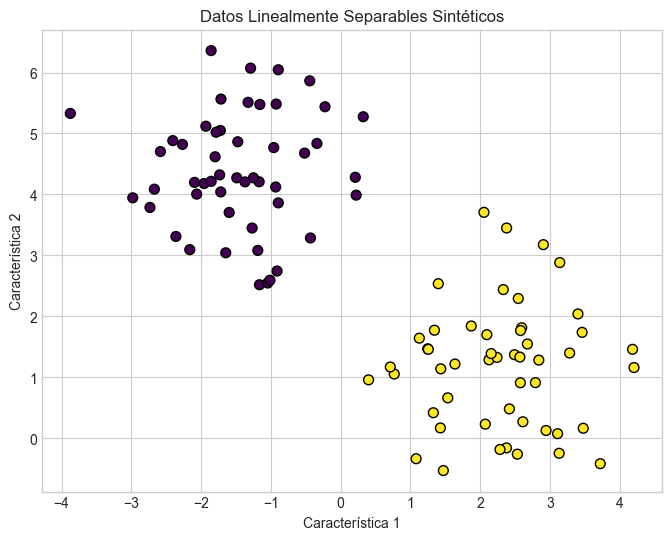

Número de actualizaciones de pesos/sesgo guardadas: 4


In [3]:
from sklearn.datasets import make_blobs # Necesitamos instalar scikit-learn

# Generar datos linealmente separables
X_sep, y_sep = make_blobs(n_samples=100, centers=2, n_features=2,
                          center_box=(-5.0, 5.0), cluster_std=1.0,
                          random_state=42) # Reproducibilidad

# Asegurarse que las etiquetas son 0 y 1
y_sep = np.where(y_sep == 0, 0, 1)

# Visualizar los datos generados
plt.figure(figsize=(8, 6))
plt.scatter(X_sep[:, 0], X_sep[:, 1], marker='o', c=y_sep, s=50, edgecolor='k', cmap='viridis')
plt.title("Datos Linealmente Separables Sintéticos")
plt.xlabel("Característica 1")
plt.ylabel("Característica 2")
plt.show()

# Crear y entrenar el perceptrón
perceptron_sep = Perceptron(learning_rate=0.1, n_iters=100) # Usaremos menos iteraciones para la animación
perceptron_sep.fit(X_sep, y_sep)

print(f"Número de actualizaciones de pesos/sesgo guardadas: {len(perceptron_sep.weights_history)}")

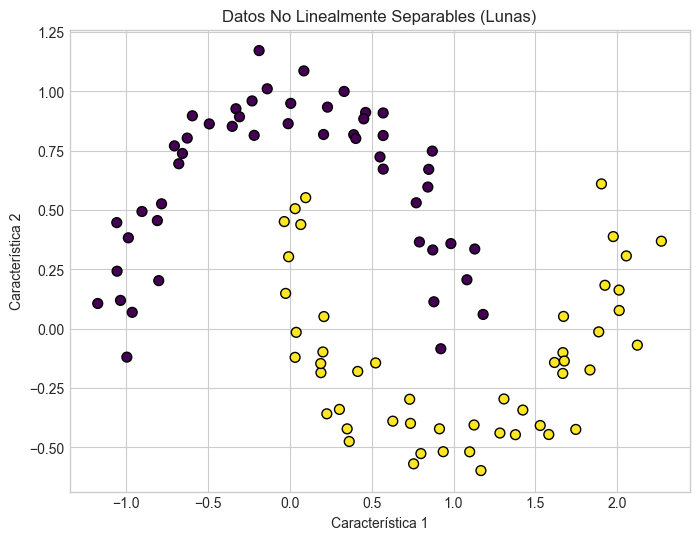

Número de actualizaciones de pesos/sesgo guardadas: 1601


In [4]:
from sklearn.datasets import make_moons

# Generar datos no linealmente separables
X_nonsep, y_nonsep = make_moons(n_samples=100, noise=0.1, random_state=42)

# Asegurarse que las etiquetas son 0 y 1 (make_moons ya las da así)
# y_nonsep = np.where(y_nonsep == 0, 0, 1) # No es necesario pero no hace daño

# Visualizar los datos generados
plt.figure(figsize=(8, 6))
plt.scatter(X_nonsep[:, 0], X_nonsep[:, 1], marker='o', c=y_nonsep, s=50, edgecolor='k', cmap='viridis')
plt.title("Datos No Linealmente Separables (Lunas)")
plt.xlabel("Característica 1")
plt.ylabel("Característica 2")
plt.show()

# Crear y entrenar un nuevo perceptrón
perceptron_nonsep = Perceptron(learning_rate=0.1, n_iters=100) # n_iters controla cuántos pasos vemos
perceptron_nonsep.fit(X_nonsep, y_nonsep)

print(f"Número de actualizaciones de pesos/sesgo guardadas: {len(perceptron_nonsep.weights_history)}")


## 3. Visualización de la Superficie de Decisión Durante el Entrenamiento

Para una comprensión más profunda, ahora visualizaremos no solo la línea límite, sino toda la *superficie de decisión* (las regiones del espacio asignadas a cada clase) y cómo evoluciona con cada actualización de pesos. Crearemos una malla de puntos en el fondo y la colorearemos según la predicción del perceptrón en ese paso específico.

In [11]:
# --- Animación con Superficie de Decisión (Linealmente Separable) ---

fig_surf_sep, ax_surf_sep = plt.subplots(figsize=(8, 6))

# --- INICIO: Añadir cálculo de límites ---
x_min_sep, x_max_sep = X_sep[:, 0].min() - 1, X_sep[:, 0].max() + 1
y_min_sep, y_max_sep = X_sep[:, 1].min() - 1, X_sep[:, 1].max() + 1
# --- FIN: Añadir cálculo de límites ---

# Crear una malla de puntos para evaluar la superficie de decisión
xx_sep, yy_sep = np.meshgrid(np.linspace(x_min_sep, x_max_sep, 100),
                             np.linspace(y_min_sep, y_max_sep, 100))
grid_points_sep = np.c_[xx_sep.ravel(), yy_sep.ravel()]

# Elementos iniciales: Puntos de datos y título
scatter_surf_sep = ax_surf_sep.scatter(X_sep[:, 0], X_sep[:, 1], marker='o', c=y_sep, s=50, edgecolor='k', cmap='viridis', zorder=2) # zorder=2 para que estén encima del fondo
title_surf_sep = ax_surf_sep.set_title("Superficie de Decisión (Linealmente Separable) - Paso 0")
ax_surf_sep.set_xlabel("Característica 1")
ax_surf_sep.set_ylabel("Característica 2")
ax_surf_sep.set_xlim(x_min_sep, x_max_sep) # Usar los límites calculados
ax_surf_sep.set_ylim(y_min_sep, y_max_sep) # Usar los límites calculados

# Contenedor para el contorno (se actualizará)
contour_surf_sep = None
# Añadir texto para mostrar accuracy
accuracy_text_sep = ax_surf_sep.text(0.02, 0.02, "Accuracy: 0.00", transform=ax_surf_sep.transAxes, 
                                   bbox=dict(facecolor='white', alpha=0.7))

def init_surf_sep():
    global contour_surf_sep
    # Eliminar el contorno anterior si existe
    if contour_surf_sep is not None:
        for coll in contour_surf_sep.collections:
            coll.remove()
    contour_surf_sep = None
    title_surf_sep.set_text("Superficie de Decisión (Linealmente Separable) - Paso 0")
    accuracy_text_sep.set_text("Accuracy: 0.00")
    # Devolvemos solo el título porque el scatter no cambia y el contorno se maneja explícitamente
    return title_surf_sep, accuracy_text_sep

def update_surf_sep(frame):
    global contour_surf_sep
    weights = perceptron_sep.weights_history[frame]
    bias = perceptron_sep.bias_history[frame]

    # Predecir en toda la malla usando los pesos/sesgo actuales
    linear_output_grid = np.dot(grid_points_sep, weights) + bias
    Z_sep = perceptron_sep._step_function(linear_output_grid)
    Z_sep = Z_sep.reshape(xx_sep.shape)

    # Calcular accuracy
    predictions = perceptron_sep._step_function(np.dot(X_sep, weights) + bias)
    accuracy = np.mean(predictions == y_sep)
    accuracy_text_sep.set_text(f"Accuracy: {accuracy:.2f}")

    # Eliminar el contorno anterior antes de dibujar el nuevo
    if contour_surf_sep is not None:
        for coll in contour_surf_sep.collections:
            coll.remove()

    # Dibujar la nueva superficie de decisión
    contour_surf_sep = ax_surf_sep.contourf(xx_sep, yy_sep, Z_sep, cmap='viridis', alpha=0.4, zorder=1)
    title_surf_sep.set_text(f"Superficie de Decisión (Linealmente Separable) - Paso {frame}")

    # Devolvemos los elementos actualizados (título y colecciones del contorno)
    return (title_surf_sep, accuracy_text_sep) + tuple(contour_surf_sep.collections)


# Crear la animación
# Usamos los mismos frames que antes, asegurándonos que perceptron_sep existe y fue entrenado
num_frames_sep = min(len(perceptron_sep.weights_history), 200) # Recalcular por si acaso
anim_surf_sep = FuncAnimation(fig_surf_sep, update_surf_sep, init_func=init_surf_sep,
                              frames=num_frames_sep, interval=100, blit=False) # blit=False suele ser necesario con contourf

plt.close(fig_surf_sep)

# Mostrar la animación
HTML(anim_surf_sep.to_jshtml())

/var/folders/y_/qfyfmtlx0dd71kh2qt_dvv100000gn/T/ipykernel_9578/111151788.py:66: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  return (title_surf_sep, accuracy_text_sep) + tuple(contour_surf_sep.collections)
/var/folders/y_/qfyfmtlx0dd71kh2qt_dvv100000gn/T/ipykernel_9578/111151788.py:58: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for coll in contour_surf_sep.collections:


In [10]:
# --- Animación con Superficie de Decisión (No Linealmente Separable) ---

fig_surf_nonsep, ax_surf_nonsep = plt.subplots(figsize=(8, 6))

# --- INICIO: Añadir cálculo de límites ---
x_min_nonsep, x_max_nonsep = X_nonsep[:, 0].min() - 0.5, X_nonsep[:, 0].max() + 0.5
y_min_nonsep, y_max_nonsep = X_nonsep[:, 1].min() - 0.5, X_nonsep[:, 1].max() + 0.5
# --- FIN: Añadir cálculo de límites ---

# Crear una malla de puntos
xx_nonsep, yy_nonsep = np.meshgrid(np.linspace(x_min_nonsep, x_max_nonsep, 100),
                                   np.linspace(y_min_nonsep, y_max_nonsep, 100))
grid_points_nonsep = np.c_[xx_nonsep.ravel(), yy_nonsep.ravel()]

# Elementos iniciales
scatter_surf_nonsep = ax_surf_nonsep.scatter(X_nonsep[:, 0], X_nonsep[:, 1], marker='o', c=y_nonsep, s=50, edgecolor='k', cmap='viridis', zorder=2)
title_surf_nonsep = ax_surf_nonsep.set_title("Superficie de Decisión (No Separable) - Paso 0")
ax_surf_nonsep.set_xlabel("Característica 1")
ax_surf_nonsep.set_ylabel("Característica 2")
ax_surf_nonsep.set_xlim(x_min_nonsep, x_max_nonsep) # Usar los límites calculados
ax_surf_nonsep.set_ylim(y_min_nonsep, y_max_nonsep) # Usar los límites calculados

# Contenedor para el contorno
contour_surf_nonsep = None
# Añadir texto para mostrar accuracy
accuracy_text = ax_surf_nonsep.text(0.02, 0.02, "Accuracy: 0.00", transform=ax_surf_nonsep.transAxes, 
                                   bbox=dict(facecolor='white', alpha=0.7))

def init_surf_nonsep():
    global contour_surf_nonsep
    if contour_surf_nonsep is not None:
        for coll in contour_surf_nonsep.collections:
            coll.remove()
    contour_surf_nonsep = None
    title_surf_nonsep.set_text("Superficie de Decisión (No Separable) - Paso 0")
    accuracy_text.set_text("Accuracy: 0.00")
    return title_surf_nonsep, accuracy_text

def update_surf_nonsep(frame):
    global contour_surf_nonsep
    weights = perceptron_nonsep.weights_history[frame]
    bias = perceptron_nonsep.bias_history[frame]

    # Predecir en la malla
    linear_output_grid = np.dot(grid_points_nonsep, weights) + bias
    Z_nonsep = perceptron_nonsep._step_function(linear_output_grid)
    Z_nonsep = Z_nonsep.reshape(xx_nonsep.shape)

    # Calcular accuracy actual
    predictions = perceptron_nonsep._step_function(np.dot(X_nonsep, weights) + bias)
    accuracy = np.mean(predictions == y_nonsep)
    accuracy_text.set_text(f"Accuracy: {accuracy:.2f}")

    # Limpiar contorno anterior
    if contour_surf_nonsep is not None:
        for coll in contour_surf_nonsep.collections:
            coll.remove()

    # Dibujar nueva superficie
    contour_surf_nonsep = ax_surf_nonsep.contourf(xx_nonsep, yy_nonsep, Z_nonsep, cmap='viridis', alpha=0.4, zorder=1)
    title_surf_nonsep.set_text(f"Superficie de Decisión (No Separable) - Paso {frame}")

    return (title_surf_nonsep, accuracy_text) + tuple(contour_surf_nonsep.collections)

# Crear la animación
# Asegurarse que perceptron_nonsep existe y fue entrenado
num_frames_nonsep = min(len(perceptron_nonsep.weights_history), 200) # Recalcular por si acaso
anim_surf_nonsep = FuncAnimation(fig_surf_nonsep, update_surf_nonsep, init_func=init_surf_nonsep,
                                 frames=num_frames_nonsep, interval=100, blit=False) # blit=False

plt.close(fig_surf_nonsep)

# Mostrar la animación
HTML(anim_surf_nonsep.to_jshtml())


/var/folders/y_/qfyfmtlx0dd71kh2qt_dvv100000gn/T/ipykernel_9578/2493418074.py:63: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  return (title_surf_nonsep, accuracy_text) + tuple(contour_surf_nonsep.collections)
/var/folders/y_/qfyfmtlx0dd71kh2qt_dvv100000gn/T/ipykernel_9578/2493418074.py:56: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for coll in contour_surf_nonsep.collections:
